In [1]:
import numpy as np

def levenshtein(seq1, seq2):
    size_x = len(seq1) + 1
    size_y = len(seq2) + 1
    matrix = np.zeros ((size_x, size_y))
    for x in range(size_x):
        matrix [x, 0] = x
    for y in range(size_y):
        matrix [0, y] = y

    for x in range(1, size_x):
        for y in range(1, size_y):
            if seq1[x-1] == seq2[y-1]:
                matrix [x,y] = min(
                    matrix[x-1, y] + 1,
                    matrix[x-1, y-1],
                    matrix[x, y-1] + 1
                )
            else:
                matrix [x,y] = min(
                    matrix[x-1,y] + 1,
                    matrix[x-1,y-1] + 1,
                    matrix[x,y-1] + 1
                )
    #print (matrix)
    return (matrix[size_x - 1, size_y - 1])

In [2]:
import pandas as pd
df = pd.read_csv('ex_lan5.csv',delimiter=';',encoding='latin')

In [8]:
df = df.loc[:,:'OC']

In [9]:
df.head()

,FR,EN,DE,ES,CT,IT,RU,PL,UK,AZ,...,SC,MK,LA,EU,WA,ML,LU,IS,IR,OC
0,maison,House,Haus,casa,casa,casa,dom,dom,Budynok,Ev,...,Taigh,Kuka,domum,Etxea,ty,Dar,Haus,Hus,Teach,ostal
1,ville,city,Stadt,ciudad,ciutat,citta,gorod,miasto,misto,sahar,...,bhaile mor,grad,urbs,hiri,ddinas,belt,Stad,borg,cathrach,ciutat
2,porte,door,Tur,puerta,porta,porta,dver,drzwi,dveri,qapi,...,doras,vrata,ianua,ate,drws,bieb,Dier,hurdh,doras,porta
3,route,road,Strasse,carretera,carretera,strada,doroga,droga,doroha,Yol,...,rathad,pat,via,errepide,ffordd,fit triq,Strooss,vegur,bothar,rota
4,homme,man,Mann,hombre,home,uomo,chelovek,mezczyzna,lyudyna,adam,...,dhuine,Covek,vir,gizon,dyn,ragel,Mann,madhur,fear,ome


In [10]:
df.shape

(94, 46)

In [11]:
colname = df.columns

In [12]:
def comp(l1, l2) :
    dl = 0
    for index, row in df.iterrows(): 
        dl += levenshtein(row[l1],row[l2])
    return (df.columns[l1], df.columns[l2], dl)

In [13]:
dfL = pd.DataFrame(index=colname, columns=colname)

for i in range(0,len(df.columns)) :
    for j in range(0,len(df.columns)):
        r = comp(i,j)
        dfL[r[0]][r[1]] = r[2]

In [14]:
dfL.head()

,FR,EN,DE,ES,CT,IT,RU,PL,UK,AZ,...,SC,MK,LA,EU,WA,ML,LU,IS,IR,OC
FR,0,490,605,422,362,379,680,628,662,624,...,708,596,516,599,602,566,597,622,623,265
EN,490,0,502,514,461,511,622,587,585,584,...,629,522,485,538,489,533,473,516,539,444
DE,605,502,0,620,571,625,675,623,641,627,...,678,578,581,602,587,630,325,580,609,571
ES,422,514,620,0,292,387,669,624,667,641,...,716,599,508,588,587,569,599,632,625,366
CT,362,461,571,292,0,361,643,611,637,601,...,661,561,487,566,540,519,554,584,567,250


In [15]:
dfD = pd.DataFrame(index=colname, columns=['x','y','z'])
for index, row in dfD.iterrows(): 
    row['x'] = np.random.random_sample()
    row['y'] = np.random.random_sample()
    row['z'] = np.random.random_sample()

In [16]:
dfD.head()

,x,y,z
FR,0.9196,0.237636,0.408729
EN,0.461135,0.880296,0.928531
DE,0.514677,0.370481,0.174328
ES,0.364676,0.890029,0.902359
CT,0.360847,0.295473,0.379949


In [17]:
from math import *
dfL2 = pd.DataFrame(index=colname, columns=colname)

for i in range(0,len(dfD.index)) :
    for j in range(0,len(dfD.index)):
        d = sqrt((dfD['x'][i]-(dfD['x'][j]))**2+(dfD['y'][i]-(dfD['y'][j]))**2+(dfD['z'][i]-(dfD['z'][j]))**2)
        dfL2[dfD.index[i]][dfD.index[j]] = d
dfL2.head()

,FR,EN,DE,ES,CT,IT,RU,PL,UK,AZ,...,SC,MK,LA,EU,WA,ML,LU,IS,IR,OC
FR,0,0.945196,0.486368,0.988549,0.562475,0.415127,0.997277,0.713786,1.15396,0.87225,...,0.755426,0.895544,0.395888,0.944597,0.672394,0.330024,0.249604,0.845448,0.569272,0.675552
EN,0.945196,0,0.911921,0.100419,0.808095,0.633618,0.472331,0.787304,0.541327,0.809378,...,0.228538,0.616557,1.0441,0.723135,0.289712,1.11026,1.06296,0.965357,0.615459,0.940954
DE,0.486368,0.911921,0,0.906895,0.267526,0.658025,0.73586,0.306429,0.869926,0.487479,...,0.738317,0.698145,0.235189,0.552848,0.647687,0.319989,0.390768,0.381345,0.317146,0.495573
ES,0.988549,0.100419,0.906895,0,0.79147,0.70243,0.409752,0.76137,0.447033,0.774567,...,0.281553,0.566412,1.05709,0.664301,0.318541,1.12854,1.09332,0.920599,0.609693,0.953039
CT,0.562475,0.808095,0.267526,0.79147,0,0.693261,0.6904,0.402792,0.75217,0.581883,...,0.687575,0.455641,0.47609,0.528097,0.546023,0.498214,0.576398,0.348086,0.348501,0.713033


In [18]:
dfL = dfL.astype("float32")
dfL2 = dfL2.astype("float32")

In [19]:
import statistics as st

In [20]:
c1 = st.mean(dfL.corrwith(dfL2))
d1 = min(dfL.corrwith(dfL2))

In [21]:
dfDT = dfD.copy()

In [22]:
from IPython.display import display, clear_output
import sys
from sty import fg, Style, RgbFg

In [23]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

57.8042 (40.6009)
0.5780421444585906


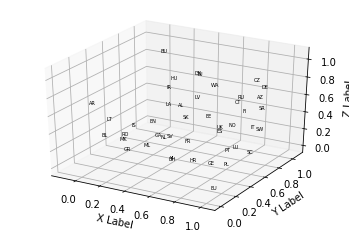

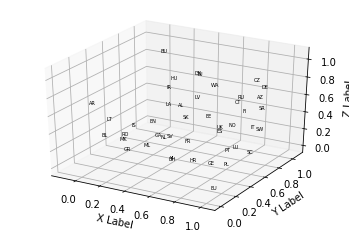

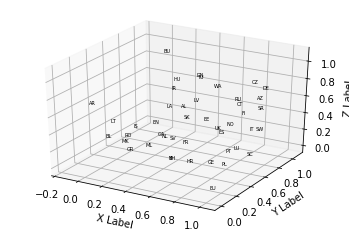

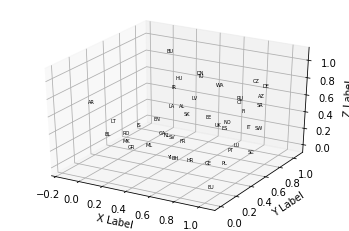

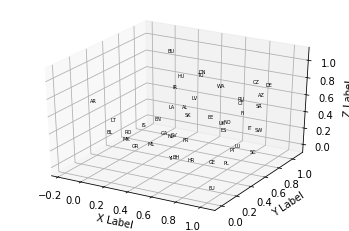

...

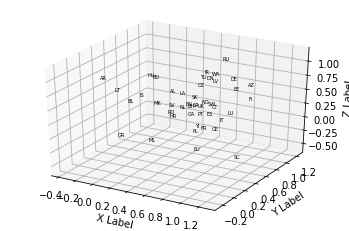

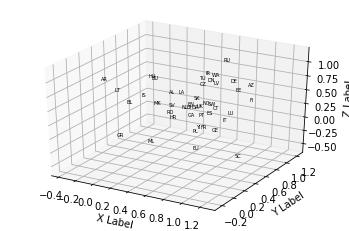

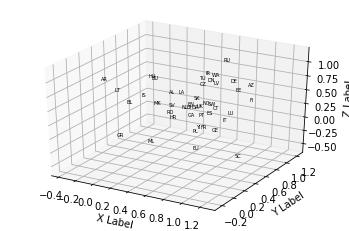

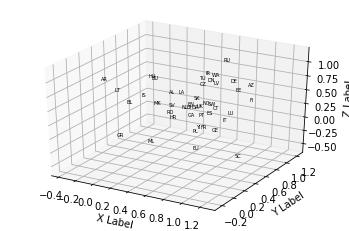

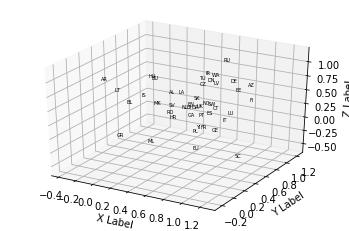

In [63]:
p = 0.1

for x in range (0,100) :   
    for index, row in dfDT.iterrows(): 
        row['x'] = np.random.normal(row['x'], p, 1)[0]
        row['y'] = np.random.normal(row['y'], p, 1)[0]
        row['z'] = np.random.normal(row['z'], p, 1)[0]

    for i in range(0,len(dfDT.index)) :
        for j in range(0,len(dfDT.index)):
            d = sqrt((dfDT['x'][i]-(dfDT['x'][j]))**2+(dfDT['y'][i]-(dfDT['y'][j]))**2+(dfDT['z'][i]-(dfDT['z'][j]))**2)
            dfL2[dfDT.index[i]][dfDT.index[j]] = d
    dfL2
    dfL = dfL.astype("float32")
    dfL2 = dfL2.astype("float32")
    c2 = st.mean(dfL.corrwith(dfL2))
    d2 = min(dfL.corrwith(dfL2))

    if c2 > c1 :
        dfD = dfDT.copy()
        c1 = c2
        d1 = d2
    else :
        dfDT = dfD.copy()
        
    sys.stdout.flush()
    clear_output(wait=True)
    print(str(round(c1*100,4))+" ("+str(round(d1*100,4))+")")
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    for index, row in dfD.iterrows(): 
        xs = row['x']
        ys = row['y']
        zs = row['z']
        n = row.name
        ax.scatter(xs, ys, zs, marker=None,s=0)
        ax.text(xs, ys, zs, n, fontsize=5)
    ax.set_xlabel('X Label')
    ax.set_ylabel('Y Label')
    ax.set_zlabel('Z Label')
    #fig = plt.figure(1, figsize=(25, 8))
    #plt.show()
    plt.savefig('img/lan_algo'+str(x)+'.png',dpi=200)

print(c1)

In [34]:
p = 0.01

for x in range (0,1000) :   
    for index, row in dfDT.iterrows(): 
        row['x'] = np.random.normal(row['x'], p, 1)[0]
        row['y'] = np.random.normal(row['y'], p, 1)[0]
        row['z'] = np.random.normal(row['z'], p, 1)[0]

    for i in range(0,len(dfDT.index)) :
        for j in range(0,len(dfDT.index)):
            d = sqrt((dfDT['x'][i]-(dfDT['x'][j]))**2+(dfDT['y'][i]-(dfDT['y'][j]))**2+(dfDT['z'][i]-(dfDT['z'][j]))**2)
            dfL2[dfDT.index[i]][dfDT.index[j]] = d
    dfL2
    dfL = dfL.astype("float32")
    dfL2 = dfL2.astype("float32")
    c2 = st.mean(dfL.corrwith(dfL2))
    d2 = min(dfL.corrwith(dfL2))

    if c2 > c1 :
        dfD = dfDT.copy()
        c1 = c2
        d1 = d2
    else :
        dfDT = dfD.copy()
        
    sys.stdout.flush()
    clear_output(wait=True)
    print(str(round(c1*100,4))+" ("+str(round(d1*100,4))+")")
    RGB = (dfD - dfD.min()) / (dfD.max() - dfD.min())*255
    for index, row in RGB.iterrows(): 
        fg.color = Style(RgbFg(int(row['x']), int(row['y']), int(row['z'])))
        buf = fg.color + row.name + fg.rs
        print(buf, sep='\n')

print(c1)

70.406 (49.989)
FR
EN
DE
ES
CT
IT
RU
PL
UK
AZ
RO
NL
TU
GR
HU
FI
EE
CZ
PT
SW
SR
BU
AR
HR
DN
AL
SK
NO
GE
BL
LT
GA
BH
SV
LV
YI
SC
MK
LA
EU
WA
ML
LU
IS
IR
OC
0.7040602604413506


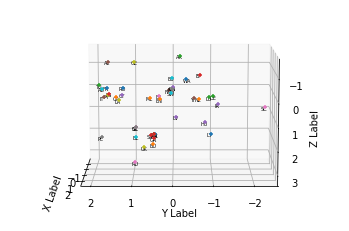

In [48]:
# This import registers the 3D projection, but is otherwise unused.
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import

import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for index, row in dfD.iterrows(): 
    xs = row['x']
    ys = row['y']
    zs = row['z']
    n = row.name
    ax.scatter(xs, ys, zs, marker="+")
    ax.text(xs+0.1, ys+0.1, zs+0.1, n, fontsize=5)

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

fig = plt.figure(1, figsize=(25, 8))
for i in range (0,36) :
    ax.view_init(30, i*10)
    fig.savefig('img/lan_3d_x'+str(i*10)+'.png',dpi=200)
 
plt.show()

for i in range (3,36) :
    ax.view_init(i*10, 0)
    fig.savefig('img/lan_3d_y'+str(i*10)+'.png',dpi=200)

#for angle in range(0, 360):
#    ax.view_init(30, angle)
#    plt.draw()
#    plt.pause(.001)

In [60]:
RGB = round((dfD - dfD.min()) / (dfD.max() - dfD.min())*239+16,0)

In [61]:
RGB

,x,y,z
FR,191.261,237.115,70.7627
EN,149.793,164.632,102.019
DE,105.949,89.7178,104.521
ES,200.472,234.992,83.7982
CT,187.881,215.182,86.2883
IT,197.725,241.011,92.0563
RU,116.728,199.315,255
PL,110.791,249.024,196.456
UK,85.9393,186.876,225.266
AZ,46.8282,249.63,93.6403


In [62]:
for index, row in RGB.iterrows(): 

    fg.color = Style(RgbFg(int(row['x']), int(row['y']), int(row['z'])))
    #print((int(row['x']), int(row['y']), int(row['z'])))
    
    buf = fg.color + row.name + fg.rs

    print(buf, sep='\n')

FR
EN
DE
ES
CT
IT
RU
PL
UK
AZ
RO
NL
TU
GR
HU
FI
EE
CZ
PT
SW
SR
BU
AR
HR
DN
AL
SK
NO
GE
BL
LT
GA
BH
SV
LV
YI
SC
MK
LA
EU
WA
ML
LU
IS
IR
